# SEE125: Numerical Integration

In these lectures, you will be introduced to several methods that can be used to numerically integrate functions in python.


Often in physics, we will want to calculate the integral of a function, which can be interpreted at the area under the curve of the function between a starting point and and ending point, as illustrated here:

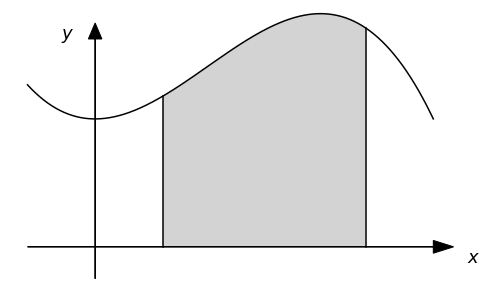

Calculating the analytical form of an integral is not always easy, and is not even guaranteed to have an analytical closed form! This is one of the reasons it is useful to calculate integrals numerically, know as Numerical Integration.

# Discretisation

As is the case for any calculation in a computer, the first step is to break our continuous variable $x$ into list of numbers `x[i]` separated by (typically) fixed steps (know as <a href=https://en.wikipedia.org/wiki/Discretization>discretising</a>), along with corresponding set of $y$ values $y[i]=f(x_i)$:

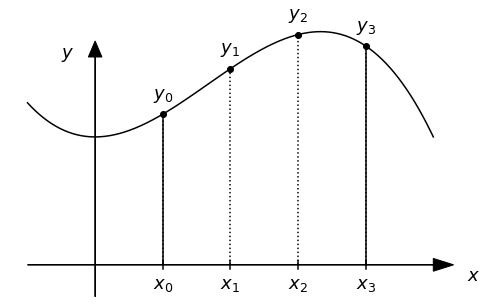

We will name the spacing between the steps in $\Delta x = h$. The example above would correspond to a total number of points $n = 4$, and following the python convention of counting from zero, the last point is then `y[3]`. 

From there, we can use several different approximations to calculate the integrated area, a few of which we will describe here. All these methods are known as **Newton-Cotes** methods. 

## Simple sum

The simplest is to simply sum up all the $f(x_i)=y[i]$ values except the last and then multiply this by the spacing $h$. For a total number of points $n$, this results in an estimate of the integral $I_{sum}$ given by: 

$$
I_{\rm sum} = h \sum_{i=0}^{n-2} f(x_i)
$$

This is equivalent to the following area graphically as an approximation of the continuous integral: 

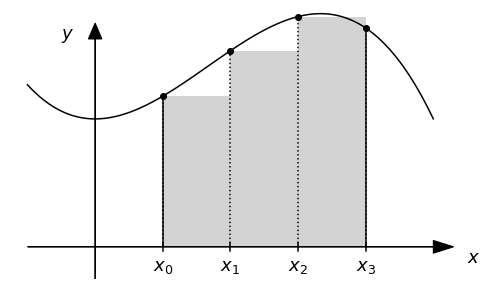

Note that the sum limit in the formula above **does not** include the last point ($i = n-1$), but instead stops at second-to-last point ($i=n-2$). This is because for $n$ points, there are $n-1$ blocks (also called **"planes"** or **"slices"**) between the first and the last points.

The illustrated example is also called the 'rectangle rule'. It can, with only a small change, also be implemented as the 'midpoint rule'. As you will see later, this (generally) already improves our estimate. 

$$
I_{\rm sum} = h \sum_{i=0}^{n-2} f(x_i+h/2)
$$

However, for discrete data points, this is obviously not a solution that works, since we can't determine the value at $x_i+h/2$.

## Trapezoidal rule

An obvious improvement over the sum rule above is to replace the "flat tops" of the boxes above with sloped lines that connect one point to the next:

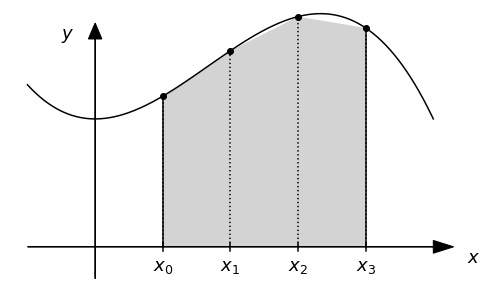

We can already see that this is giving a much better approximation! The formula for the estimated integral using the trapezoidal rule is given by:

$$
I_{\rm trap} =  h \left( \frac{f(x_0) + f(x_{n-1})}{2} + \sum_{i=1}^{n-2} f(x_i) \right)
$$

<font color='red'>Blackboard derivation.</font>

The formula is in fact nearly identical to the simple sum, except that instead of using the first point and skipping the last point, we replace the first point with average of the first and last points. 

## Simpson's rule

While the trapezoidal rule is clearly much better, we can do even better if we use a quadratic interpolation instead of a linear interpolation between the points. This technique is known as Simpson's rule. (https://en.wikipedia.org/wiki/Simpson%27s_rule)

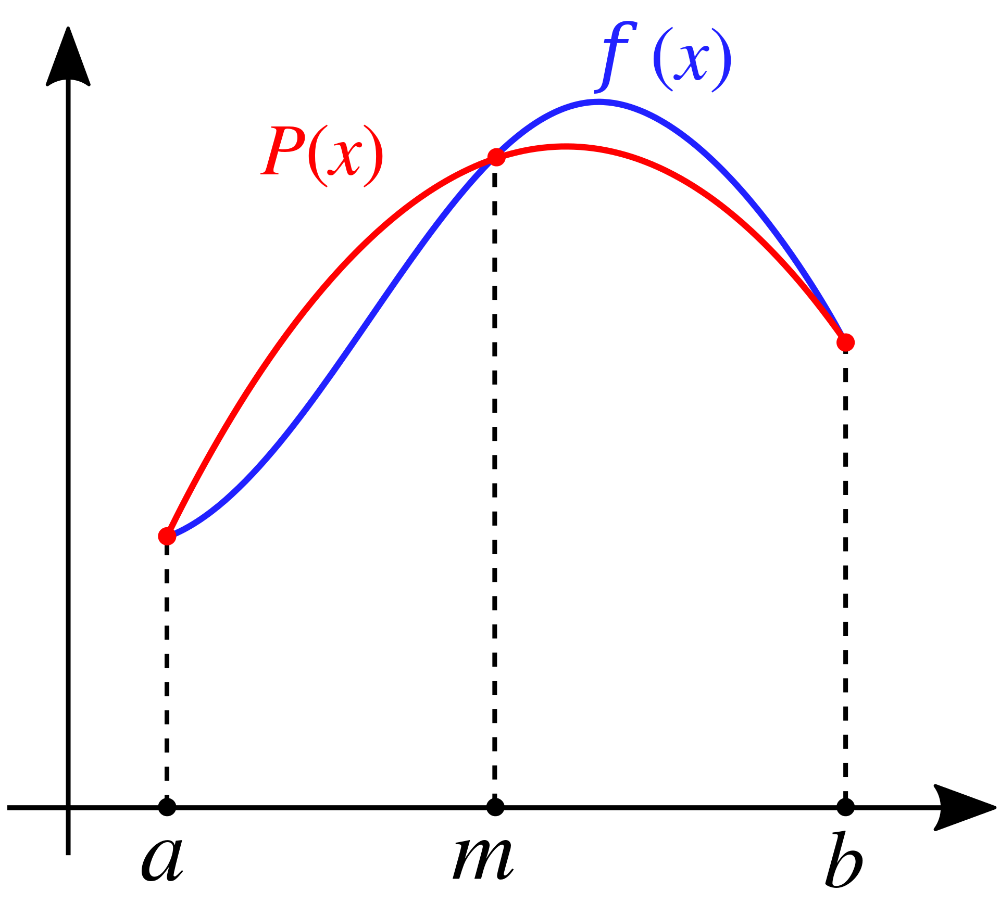

In this case, the estimate of the integral is given by a more complicated sum involving different coefficients for the odd and even points:

$$
I_{\rm simp} = \frac{h}{3}\left( f(x_0) + 2\sum_{i=1}^{n/2-1}f(x_{2i}) + 4\sum_{i=1}^{n/2}f(x_{2i-1}) + f(x_n) \right)
$$

<font color='red'>Blackboard derivation (using Lagrange interpolation).</font>


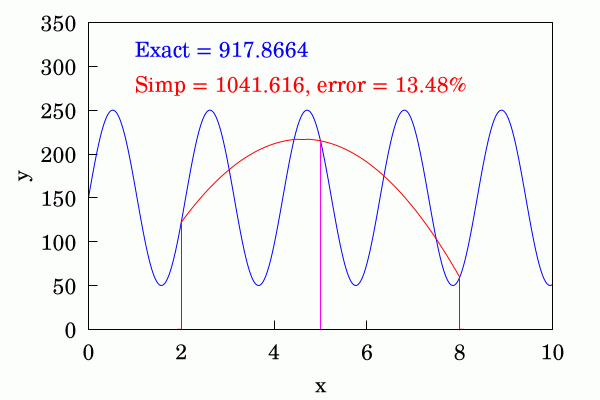

# Adaptive integration

Now you have seen three different approximations that can be used to give you a numerical integration result. But the accuracy of each method depends on how many sampling points $n$ you use for your function. Of course, when you are using discrete data points, you have in principle no information on the behaviour of the underlying function between these points. (<font color='red'>Discuss some examples.</font>)

But when your are approximating the intergral of a numerically implemented function, you will have the freedom to choose your value of $n$, which you in principle want to have as small as possible (to avoid using expensive computational resources) but still large enough to reach a certain required accuracy.

To arrive at the adaptive integration method and the dependence of the error on the value of $n$ we first look at the errors of some of the different methods (you'll look at this numerically in the exercises).

<font color='red'>Derive the error for the rectangle rule on the blackboard.</font>

Here follows a summary of the panels, weights and errors per panel interval for the four methods described previously.

| Method | Panels | Polynomial | Weights | Absolute error (per panel(s)) |
| :- | :- | :- | :- | :-------- | 
| Rectangle | 1 | Constant | $h$ | $\frac{1}{2}h^2 f'(\xi_i)$ | 
| Midpoint | 1$^*$ | Constant | $h$ | $\frac{1}{24}h^3 f''(\xi_i)$ |
| Trapezoid | 1 | Straight line | $\frac{h}{2}(1,1)$ | $-\frac{1}{12}h^3 f''(\xi_i)$ |
| Simpson's | 2 | Quadratic | $\frac{h}{3}(1,4,1)$ | $-\frac{1}{90}h^5 f^{(4)}(\xi_i)$ |

$*$ (Remember the midpoint rule needs an evaluation in the center of each panel)

As a rule, the *total* error scales as the error per panel divided by $h$!

Clearly, all methods give better approximations when the number of sampling points $n$ increases. Adaptive integration typically means that one implements an evaluation using double the number of panels (remember that this is not quite the same as doubling the number of sampling points as the number of panels $N(=n-1$). But as we don't know the true value of the intergral we are interested in, how can we decide that we have reached sufficient accuracy? One method is to simply judge that the change in calculated value no longer changes by more than your threshold value. But we can do slightly better.

Using the known relations from above, one can calculate the expected error for each doubling of the number of panels $N'=2N$. For example for Simpson's rule we arrive at the following. Define:
\begin{equation}
h_N = \frac{b-a}{N}
\end{equation}
then obviously:
\begin{equation}
h_{N'} = \frac{b-a}{{N'}} = \frac{h_N}{2}
\end{equation}
The absolute error of Simpson's rule, with $N$ panels is $\mathcal{E}_N=ch^4_N$ (assuming constant $c$).

So our unknown integral:
\begin{equation}
I = I_N + ch^4_N = I_{N'} + ch^4_{N'}
\end{equation}
thus
\begin{equation}
I_{N'} - I_N = ch^4_N - ch^4_{N'} = 15 ch^4_N
\end{equation}
Thus, we get the error as a function of both integration results:
\begin{equation}
\mathcal{E}_{N} = \frac{1}{15}(I_{N'} - I_N)
\end{equation}

So when you do not know what the exact value of the integral $I$ is, you can still determine an estimate of the error that you can use in a *loop* to decide when your accuracy is sufficient. I leave it up to you to determine what the same formulas are for the other methods.

# Infinite integrals and singularities

As you can imagine, things get more complicated when trying to numerically calculate integrals to go to infinity or that include singularities. The solution to this problem is to (if possible; obviously not all integrals have a finite value) make a change of variables and/or slice the problem up in separate pieces, parts of which that have for example an analytical solution. Typical variable substitutions are e.g. $\sqrt{x}$ or $1/x^n$.

Or $u=\phi(x)$ if:

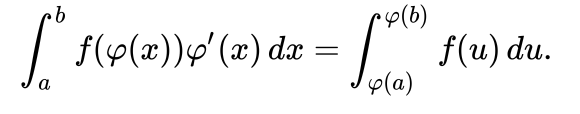

<font color='red'>Think about the following example:</font>

$I=\int_{1}^{\infty} e^{-(x+6)^{-1}} {{1}\over{x^3}} \,dx$ [the answer should be $\sim 0.44$]



In [1]:
import numpy as np
import matplotlib.pyplot as plt

def f2(x):
    return np.exp(-1/(x+6))/x**3.

# rewrite using u=1/x^2, the interval becomes 0 to 1
def g2(u):
    ex=-1*np.sqrt(u)/(1+6*np.sqrt(u))
    return 0.5*np.exp(ex)

a=1
b=np.inf
from scipy.integrate import quad
print(quad(f2,a,b))
print(quad(g2,0,1))

(0.43949077230410666, 1.7308421361485687e-09)
(0.4394907723042096, 6.0754377639860024e-09)


# Using *Quad*

In [2]:
from scipy.integrate import quad
help(quad)

Help on function quad in module scipy.integrate._quadpack_py:

quad(func, a, b, args=(), full_output=0, epsabs=1.49e-08, epsrel=1.49e-08, limit=50, points=None, weight=None, wvar=None, wopts=None, maxp1=50, limlst=50, complex_func=False)
    Compute a definite integral.
    
    Integrate func from `a` to `b` (possibly infinite interval) using a
    technique from the Fortran library QUADPACK.
    
    Parameters
    ----------
    func : {function, scipy.LowLevelCallable}
        A Python function or method to integrate. If `func` takes many
        arguments, it is integrated along the axis corresponding to the
        first argument.
    
        If the user desires improved integration performance, then `f` may
        be a `scipy.LowLevelCallable` with one of the signatures::
    
            double func(double x)
            double func(double x, void *user_data)
            double func(int n, double *xx)
            double func(int n, double *xx, void *user_data)
    
        Th

# Multi-dimensional integrals

Now we focus on integrating multi-dimensional functions. Although there are several difference methods, we will discuss only one. Monte Carlo integration. (And for simplicity we actually focus on a derivation in 1D).

## Monte Carlo integration

It is probably most intuitive, to return to a single dimension to introduce the Monte Carlo integration method.

The most important part of Monte Carlo integration requires you to understand the *law of the unconcious statistician*. This states that the expected ($E$, average) value of a function $f(x)$ can be defined as:
\begin{eqnarray}
\langle f(x) \rangle = E[f(x)] = \int f(x)P_x(x) dx
\end{eqnarray}
Here $P_x(x)$ is the *probability distribution function* of the variable $x$. The easiest when integrating in the interval $[a, b]$ is to take:
\begin{equation}
P_x(x) = 1/(b-a), [a<x<b]\\
P_x(x) = 0, {\rm otherwise}
\end{equation}
You see that $P_x$ integrates to $1$. The equation then becomes:
\begin{equation}
\langle f(x) \rangle = \frac{1}{b-a} \int_a^b f(x) dx
\end{equation}
which contains the integral we are trying to determine.

The law of large numbers also states that, for $N\rightarrow\infty$:
\begin{equation}
\langle f(x) \rangle = \frac{1}{N}\sum_{i=0}^{N-1} f(X_i),
\end{equation}
Where the values $X_i$ are uniformly distributed. This means that if we uniformly sample the interval $[a, b]$ with $N$ samples:
\begin{equation}
\langle f(x) \rangle = \frac{1}{b-a} \int_a^b f(x) dx \approx \frac{1}{N}\sum_{i=0}^{N-1} f(X_i),
\end{equation}
and thus:
\begin{equation}
\int_a^b f(x) dx \approx (b-a) \frac{1}{N}\sum_{i=0}^{N-1} f(X_i)
\end{equation}

Because we are using basic statistics, this also provides a straightforward estimate of the *uncertainty* of the Monte Carlo integration. For this we can use the *variance*.

\begin{equation}
{\rm var}[f(x)] = \langle f(x)^2 \rangle - \langle f(x) \rangle^2.
\end{equation}
with (as above):
\begin{equation}
\langle f(x) \rangle = \frac{1}{N}\sum_{i=0}^{N-1} f(X_i)
\end{equation}
and
\begin{equation}
\langle f(x)^2 \rangle = \frac{1}{N}\sum_{i=0}^{N-1} f(X_i)^2
\end{equation}

This is the variance of the function itself. We can calcuate the error on the integral $\sigma_I$ from this. First, the variance on the *mean* of the function is 
$\frac{{\rm var}[f(x)]}{N}$ when sampled by $N$ random points. 
The error, or standard deviation is the square-root of the variance, and we have to multiple (just like we did for the intergral) with the interval. 

The error on the integration is then:
\begin{equation}
\sigma_I = (b-a) \sqrt{\frac{{\rm var}[f(x)]}{N}}
\end{equation}

In [3]:
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (14,10)
plt.rcParams['axes.linewidth'] = 3
plt.rcParams['axes.labelsize'] = 25
plt.rcParams['axes.titlesize'] = 25
plt.rcParams['xtick.labelsize'] = 25
plt.rcParams['ytick.labelsize'] = 25
import numpy as np
from matplotlib.animation import FuncAnimation

Here is an example for the intergral:
\begin{equation}
\int_0^{2\pi} (e^{-x/3} \sin{x} + 1)dx
\end{equation}

In [4]:
def func(xx):
    return np.exp(-xx/3)*np.sin(xx)+1

a=0
b=2*np.pi
from scipy.integrate import quad
answer=quad(func,a,b)
print(' Integral: ',answer[0])    

 Integral:  7.072355067216467


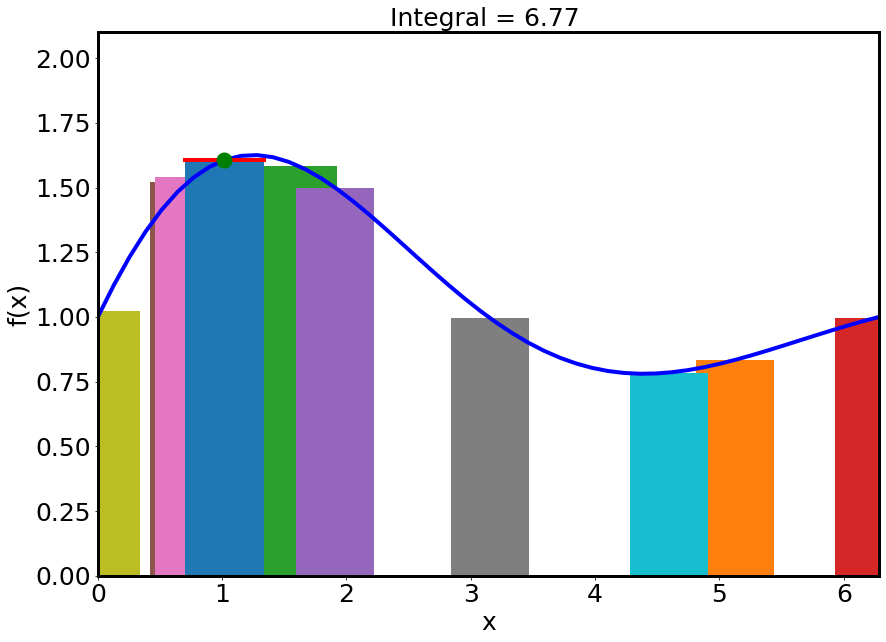

In [5]:
fig, ax = plt.subplots()
line, = ax.plot([], [], 'b', lw=4)    
line2, = ax.plot([], [], 'r', lw=4) 
pt2, = ax.plot([], [], 'g.', ms=30)
ax.set_xlim(0, 2*np.pi)
ax.set_ylim(0, 2.1)
ax.set_xlabel("x")
ax.set_ylabel("f(x)")
txt_title = ax.set_title('')

nframes = 10  # should not be much bigger than 250, otherwise FuncAnimation becomes slow
interv = int(5000/nframes)
x = np.linspace(0, 2*np.pi)
h = 2*np.pi/nframes
mcp = np.random.uniform(0,2*np.pi,nframes) # an array with nframes random values between 0,2pi

# For illustration, imagine this lucky random sequence
#mcp=np.array([h*(i+0.5) for i in range(nframes)]) 

def func(xx):
    return np.exp(-xx/3)*np.sin(xx)+1
    
def animate(frame_num):
#    ax.collections.clear()
    y = func(x)
    line.set_data((x, y))
    x2=mcp[frame_num]
    x2h=[x2-0.5*h,x2+0.5*h]
    y2 = func(x2)
    line2.set_data((x2h,y2))
    pt2.set_data(x2,y2)
    ax.fill_between(x2h,y2)
    integral=2*np.pi*np.sum(func(mcp[0:frame_num]))/(frame_num+1)
    txt_title.set_text('Integral = {:.2f} '.format(integral))
    return

anim = FuncAnimation(fig, animate, frames=nframes, interval=interv)

from IPython.display import HTML
HTML(anim.to_jshtml())

### Importance sampling

*Importance sampling* allows us to optimize the otherwise rather costly uniform random number generation for cases where parts of the integral contribute much less than other parts. Consider for example the integral of the Gaussian function:
\begin{equation}
\int_0^2 e^{-x^2} dx
\end{equation}

In [6]:
def func(xx):
    return np.exp(-xx**2)
    
answer=quad(func,0,2)
print(' Integral: ',answer[0])    

 Integral:  0.8820813907624215


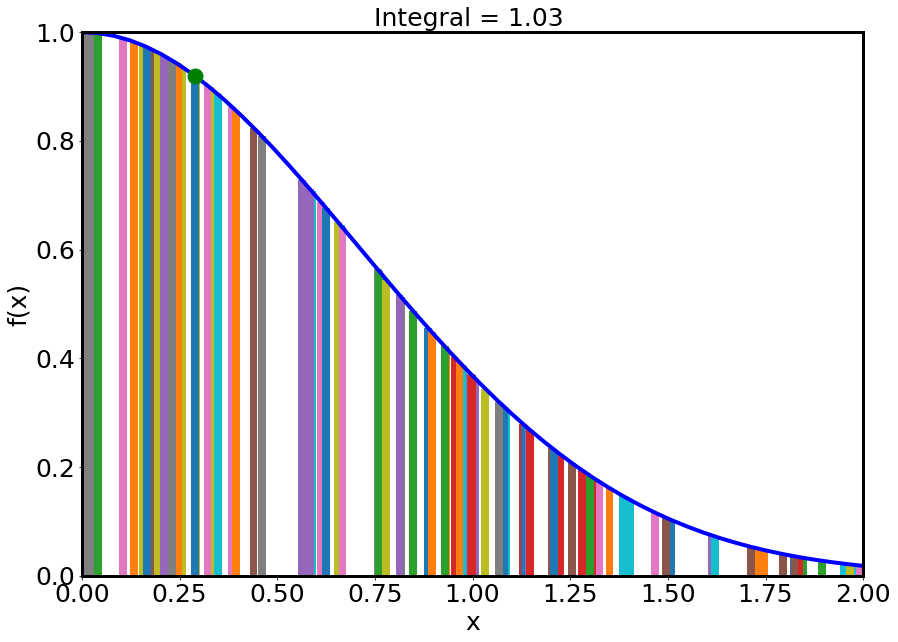

In [7]:
fig, ax = plt.subplots()
line, = ax.plot([], [], 'b', lw=4)    
line2, = ax.plot([], [], 'r', lw=4) 
pt2, = ax.plot([], [], 'g.', ms=30)
ax.set_xlim(0, 2)
ax.set_ylim(0, 1)
ax.set_xlabel("x")
ax.set_ylabel("f(x)")
txt_title = ax.set_title('')

nframes = 100
interv = int(10000/nframes)
x = np.linspace(0, 2)
h = 2/nframes
mcp = np.random.uniform(0,2,nframes) # here we select uniformly distributed random samples in [0,2]

def animate(frame_num):
#    ax.collections.clear()
    y = func(x)
    line.set_data((x, y))
    x2=mcp[frame_num]
    x2h=[x2-0.5*h,x2+0.5*h]
    y2 = func(x2)
    line2.set_data((x2h,y2))
    pt2.set_data(x2,y2)
    ax.fill_between(x2h,y2)
    integral=2*np.sum(func(mcp[0:frame_num]))/(frame_num+1) # this is the integral of func
    txt_title.set_text('Integral = {:.2f} '.format(integral))
    return

anim = FuncAnimation(fig, animate, frames=nframes, interval=interv)

from IPython.display import HTML
HTML(anim.to_jshtml())

It is clear that the randomly selected $x\gtrsim 1.25$ do not contribute much to the integral. If we could somehow decide to select those values of $x$ where the function values are higher, it should speed up the process. 

We can do that by introducing a weight function $w(x)$:
\begin{equation}
(1) \int_a^b f(x)dx = \int_a^b w(x)\frac{f(x)}{w(x)} dx
\end{equation}
and then make a change of variable so that
\begin{equation}
du = w(x)dx
\end{equation}
and thus
\begin{equation}
u(x) = \int_a^x w(x')dx'
\end{equation}
inverting this to obtain $x(u)$, $(1)$ can then be written as:
\begin{equation}
\int_a^b f(x)dx = \int_a^b w(x)\frac{f(x)}{w(x)} dx = \int_0^{b-a} \frac{f(x(u))}{w(x(u))}du \approx \frac{b-a}{n}\sum^{n-1}_{i=0}\frac{f(X(U_i))}{w(X(U_i))}
\end{equation}

If now the $U_i$ are uniformly distributed from $0$ to $b-a$ the resulting $X_i$ are weighted by the weight function ($w(x)$) which you should chose to mimic the behaviour of $f(x)$. Of course, one should choose a function $w(x)$ that can be integrated easily because this is needed to determine $u(x)$. 

Now back to the example:
\begin{equation}
\int_0^2 e^{-x^2} dx
\end{equation}

Let's choose a linear weight function $w(x)=c_0-c_1 x$ (note that we have to make sure that $w(x)\ne 0$). We find:
\begin{equation}
u(x) = \int_0^x w(x')dx' = c_0 x- \frac{c_1}{2} x^2
\end{equation}
We already see that $u(x=0)=0$ and want $u(x=b-a)=u(2)=2$. Thus $c_0-c_1=1$. We pick $c_0=1.5$ and $c_1=0.5$ (remember $w(x)\ne 0)$. Thus:
\begin{equation}
u(x) = \int_0^x w(x')dx' = 1.5 x- 0.25x^2
\end{equation}
Solving this for $x(u)$ requires finding the roots of $-0.25 x^2+1.5x-u=0$. We specifically want the one that keeps $u=[0,2]$ for $x=[0,2]$. This means:
\begin{equation}
x(u)=3 - \sqrt{9-4u}
\end{equation}

The integral can thus be solved using this weight function by using:
\begin{equation}
\int_0^2 e^{-x^2} dx = \int_0^2 \frac{e^{-x(u)^2}}{1.5-0.5x(u)} du \approx \frac{2}{n}\sum^{n-1}_{i=0}\frac{e^{-X(U_i)^2}}{1.5 - 0.5X(U_i)}
\end{equation}

As you see here (and will notice in the exercises), this often speeds up the Monte Carlo integration.

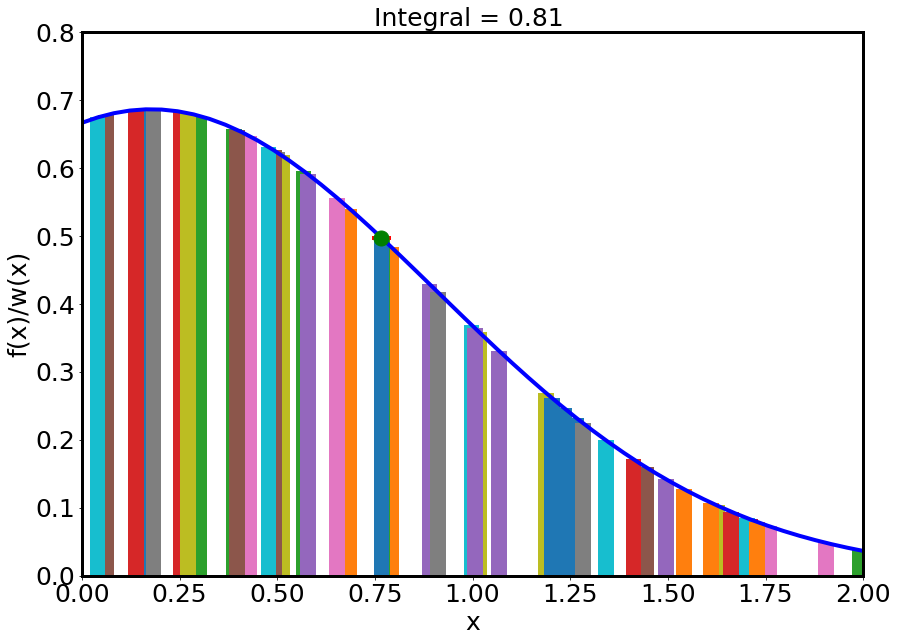

In [8]:
def w(x):
    return (1.5-0.5*x)

def func(xx):
    return np.exp(-xx**2)/(w(xx)) # the function now contains the weight function w

fig, ax = plt.subplots()
line, = ax.plot([], [], 'b', lw=4)    
line2, = ax.plot([], [], 'r', lw=4) 
pt2, = ax.plot([], [], 'g.', ms=30)
ax.set_xlim(0, 2)
ax.set_ylim(0, 0.8)
ax.set_xlabel("x")
ax.set_ylabel("f(x)/w(x)")
txt_title = ax.set_title('')

nframes = 50
interv = int(10000/nframes)
x = np.linspace(0, 2)
h = 2/nframes
umcp = np.random.uniform(0,2,nframes) # The uniformly distributed random values of U
mcp=3-np.sqrt(9-4*umcp) # here we make the conversion to X(U)

def animate(frame_num):
#    ax.collections.clear()
    y = func(x)
    line.set_data((x, y))
    x2=mcp[frame_num]
    x2h=[x2-0.5*h,x2+0.5*h]
    y2 = func(x2)
    line2.set_data((x2h,y2))
    pt2.set_data(x2,y2)
    ax.fill_between(x2h,y2)
    integral=2*np.sum(func(mcp[0:frame_num]))/(frame_num+1)
    txt_title.set_text('Integral = {:.2f} '.format(integral))
    return

anim = FuncAnimation(fig, animate, frames=nframes, interval=interv)

from IPython.display import HTML
HTML(anim.to_jshtml())

### Rejection sampling

Another way of using the Monte Carlo method to calculate an integral is by doing rejection sampling. Here you select an area that encompasses your function $f(x)$ and for which you easily can calculate the area (or multi-dimensional volume). If you take uniformly distributed random samples $(x_i,y_i)$in this area, and reject the sampled points that lie outside you function (when $y_i>f(x_i)$), then the area under your function (the integral $I$ you want to calculate) is given by:
\begin{equation}
I = A\frac{N_{y_i<f(x_i)}}{N_{\rm total}},
\end{equation}
where $A$ is the known area that you sampled (typically a rectangle, or cube or high dimensional equivalen).

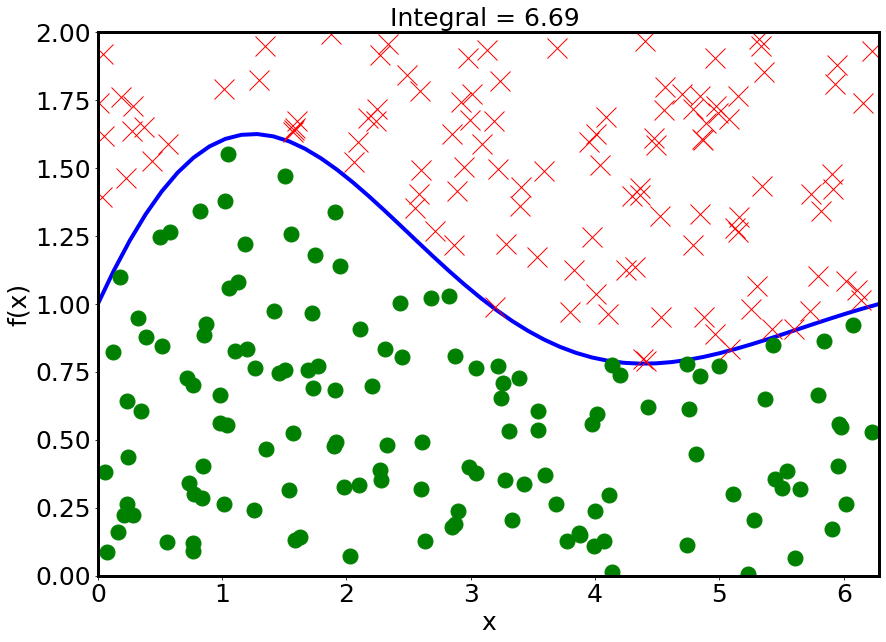

In [9]:
fig, ax = plt.subplots()
line, = ax.plot([], [], 'b', lw=4)     
pt1, = ax.plot([], [], 'g.', ms=30)
pt2, = ax.plot([], [], 'rx', ms=20)
ax.set_xlim(0, 2*np.pi)
ax.set_ylim(0, 2)
ax.set_xlabel("x")
ax.set_ylabel("f(x)")
txt_title = ax.set_title('')

nframes = 250

x = np.linspace(0, 2*np.pi)
mcp = np.random.uniform(0,1,(nframes,2))  # create a uniform sampled 2d array from [0,1;0,1]
mcp[:,0]*=2*np.pi  # transform the x-values to the interval [0,2pi]
mcp[:,1]*=2 # and the y-interval to [0,2]
area=4*np.pi

def func(xx):
    return np.exp(-xx/3)*np.sin(xx)+1
    
def animate(frame_num):
#    ax.collections.clear()
    y = func(x)
    line.set_data((x, y))
    xyes=[]
    yyes=[]
    xno=[]
    yno=[]
    for i in range(frame_num):
        x1=mcp[i,0]
        y1=mcp[i,1]
        fx1=func(x1)
        if (y1<fx1):
            xyes.append(x1)
            yyes.append(y1)
        else:
            xno.append(x1)
            yno.append(y1)       
    pt1.set_data(xyes,yyes)
    pt2.set_data(xno,yno)
    integral=area*(len(xyes)-1)/(frame_num+1)
    txt_title.set_text('Integral = {:.2f} '.format(integral))
    return

anim = FuncAnimation(fig, animate, frames=nframes, interval=50)

from IPython.display import HTML
HTML(anim.to_jshtml())

The Monte Carlo methods are trivial to expand to multi-dimensional functions (although importance sampling could be complicated).